### include release strategy in figure

In [1]:
#imports
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sys import platform
from datetime import timedelta
import matplotlib.gridspec as gridspec
import math

if platform == "linux" or platform == "linux2":
    data_string = "/home/maria/Documents/data/pied_piper/"
    output_string = "/home/maria/Documents/output/pied_piper/"
else:
    data_string = "C:/Users/maria/OneDrive/Documents/data/pied_piper/"
    output_string = "C:/Users/maria/OneDrive/Documents/output/pied_piper/"


In [23]:
df = pd.read_csv("https://www.rmis.org/reports/CSV15035.txt")

# add column for species name
df_species = pd.DataFrame({'species':[1,2,3,4,5,6,7,8,9], 
                          'species_name':['chinook','coho','steelhead', 
                                          'sockeye','chum','pink','masu', 'cutthroat','atlantic']})

df_combine = df.merge(df_species, how = 'left', validate = 'many_to_one', on = 'species')

# change date format

#calculate unclipped and untagged
df_combine['first_release_date'] =  pd.to_datetime(df_combine['first_release_date'], format='%Y%m%d')
df_combine['last_release_date'] =  pd.to_datetime(df_combine['last_release_date'], format='%Y%m%d')
df_combine['total'] = (df_combine['tagged_adclipped'] + df_combine['tagged_unclipped'] + 
                       df_combine['untagged_adclipped'] + df_combine['untagged_unclipped'] + 
                       df_combine['untagged_unknown'])
df_combine['prop_untagged_unclipped'] = (df_combine['untagged_unclipped']+ 
                                         df_combine['untagged_unknown'])/df_combine['total']

#calculate age
df_combine['age'] = df_combine['first_release_date'].dt.year - df_combine['brood_year'] - 1

subset_df = df_combine[(df_combine['first_release_date'].dt.year >= 2005) & (df_combine['first_release_date'].dt.year <= 2020)]

#need to combine this dataset with the hatchery dataset

df_trap = pd.read_csv(data_string + "dungeness_all_days.csv", header = 0)


#chinook0
chinook0_df = pd.DataFrame()
chinook0_df['Date'] = subset_df['first_release_date'][subset_df['species_name'] == 'chinook'][subset_df['age']==0]
chinook0_df['chinook0_hatchery_total_release'] = subset_df['total'][subset_df['species_name'] == 'chinook'][subset_df['age']==0]

chinook0_df['release_strategy_chinook0'] = subset_df['release_strategy'][subset_df['species_name'] == 'chinook'][subset_df['age']==0]
chinook0_df['release_strategy_chinook0'] = chinook0_df['release_strategy_chinook0'].astype(str)
chinook0_df['chinook0_untagged_unclipped'] = subset_df['untagged_unclipped'][subset_df['species_name'] == 'chinook'][subset_df['age']==0]

chinook0_df['chinook0_untagged_unclipped_prop'] = subset_df['prop_untagged_unclipped'][subset_df['species_name'] == 'chinook'][subset_df['age']==0]
grouped_chinook0_df = chinook0_df.groupby(by=["Date"]).agg({'chinook0_hatchery_total_release':'sum',
                                                            'chinook0_untagged_unclipped':'sum',
                                                            'release_strategy_chinook0': ' '.join})
grouped_chinook0_df['chinook0_untagged_unclipped_prop'] = (grouped_chinook0_df['chinook0_untagged_unclipped']/
                                                           grouped_chinook0_df['chinook0_hatchery_total_release'])





#chinook1
chinook1_df = pd.DataFrame()
chinook1_df['Date'] = subset_df['first_release_date'][subset_df['species_name'] == 'chinook'][subset_df['age']==1]
chinook1_df['chinook1_hatchery_total_release'] = subset_df['total'][subset_df['species_name'] == 'chinook'][subset_df['age']==1]


chinook1_df['release_strategy_chinook1'] = subset_df['release_strategy'][subset_df['species_name'] == 'chinook'][subset_df['age']==1]

chinook1_df['release_strategy_chinook1'] = chinook1_df['release_strategy_chinook1'].astype(str)



chinook1_df['chinook1_untagged_unclipped'] = subset_df['untagged_unclipped'][subset_df['species_name'] == 'chinook'][subset_df['age']==1]

chinook1_df['chinook1_untagged_unclipped_prop'] = subset_df['prop_untagged_unclipped'][subset_df['species_name'] == 'chinook'][subset_df['age']==1]
grouped_chinook1_df = chinook1_df.groupby(by=["Date"]).agg({'chinook1_hatchery_total_release':'sum',
                                                             'chinook1_untagged_unclipped':'sum',
                                                            'release_strategy_chinook1': ' '.join})

grouped_chinook1_df['chinook1_untagged_unclipped_prop'] = (grouped_chinook1_df['chinook1_untagged_unclipped']/
                                                           grouped_chinook1_df['chinook1_hatchery_total_release'])


#coho1
coho1_df = pd.DataFrame()
coho1_df['Date'] = subset_df['first_release_date'][subset_df['species_name'] == 'coho'][subset_df['age']==1]
coho1_df['coho1_hatchery_total_release'] = subset_df['total'][subset_df['species_name'] == 'coho'][subset_df['age']==1]


coho1_df['release_strategy_coho1'] = subset_df['release_strategy'][subset_df['species_name'] == 'coho'][subset_df['age']==1]

coho1_df['release_strategy_coho1'] = coho1_df['release_strategy_coho1'].astype(str)



coho1_df['coho1_untagged_unclipped'] = subset_df['untagged_unclipped'][subset_df['species_name'] == 'coho'][subset_df['age']==1]

coho1_df['coho1_untagged_unclipped_prop'] = subset_df['prop_untagged_unclipped'][subset_df['species_name'] == 'coho'][subset_df['age']==1]
grouped_coho1_df = coho1_df.groupby(by=["Date"]).agg({'coho1_hatchery_total_release':'sum',
                                                             'coho1_untagged_unclipped':'sum',
                                                            'release_strategy_coho1': ' '.join})
grouped_coho1_df['coho1_untagged_unclipped_prop'] = (grouped_coho1_df['coho1_untagged_unclipped']/
                                                           grouped_coho1_df['coho1_hatchery_total_release'])


#coho0
coho0_df = pd.DataFrame()
coho0_df['Date'] = subset_df['first_release_date'][subset_df['species_name'] == 'coho'][subset_df['age']==0]
coho0_df['coho0_hatchery_total_release'] = subset_df['total'][subset_df['species_name'] == 'coho'][subset_df['age']==0]


coho0_df['release_strategy_coho0'] = subset_df['release_strategy'][subset_df['species_name'] == 'coho'][subset_df['age']==0]

coho0_df['release_strategy_coho0'] = coho0_df['release_strategy_coho0'].astype(str)





coho0_df['coho0_untagged_unclipped'] = subset_df['untagged_unclipped'][subset_df['species_name'] == 'coho'][subset_df['age']==0]

coho0_df['coho0_untagged_unclipped_prop'] = subset_df['prop_untagged_unclipped'][subset_df['species_name'] == 'coho'][subset_df['age']==0]
grouped_coho0_df = coho0_df.groupby(by=["Date"]).agg({'coho0_hatchery_total_release':'sum',
                                                             'coho0_untagged_unclipped':'sum',
                                                            'release_strategy_coho0': ' '.join})
grouped_coho0_df['coho0_untagged_unclipped_prop'] = (grouped_coho0_df['coho0_untagged_unclipped']/
                                                           grouped_coho0_df['coho0_hatchery_total_release'])

#steelheadsmolt
steelheadsmolt_df = pd.DataFrame()
steelheadsmolt_df['Date'] = subset_df['first_release_date'][subset_df['species_name'] == 'steelhead'][subset_df['age']==0]
steelheadsmolt_df['steelheadsmolt_hatchery_total_release'] = subset_df['total'][subset_df['species_name'] == 'steelhead'][subset_df['age']==0]



steelheadsmolt_df['release_strategy_steelheadsmolt'] = subset_df['release_strategy'][subset_df['species_name'] == 'steelhead'][subset_df['age']==0]

steelheadsmolt_df['release_strategy_steelheadsmolt'] = steelheadsmolt_df['release_strategy_steelheadsmolt'].astype(str)




steelheadsmolt_df['steelheadsmolt_untagged_unclipped'] = subset_df['untagged_unclipped'][subset_df['species_name'] == 'steelhead'][subset_df['age']==0]

steelheadsmolt_df['steelheadsmolt_untagged_unclipped_prop'] = subset_df['prop_untagged_unclipped'][subset_df['species_name'] == 'steelhead'][subset_df['age']==0]
grouped_steelheadsmolt_df = steelheadsmolt_df.groupby(by=["Date"]).agg({'steelheadsmolt_hatchery_total_release':'sum',
                                                             'steelheadsmolt_untagged_unclipped':'sum',
                                                            'release_strategy_steelheadsmolt': ' '.join})
grouped_steelheadsmolt_df['steelheadsmolt_untagged_unclipped_prop'] = (grouped_steelheadsmolt_df['steelheadsmolt_untagged_unclipped']/
                                                           grouped_steelheadsmolt_df['steelheadsmolt_hatchery_total_release'])


df_trap['Date']=pd.to_datetime(df_trap['Date'])
df_trap = df_trap.merge(grouped_chinook0_df, on = 'Date', how = 'left', validate = 'one_to_one')
df_trap = df_trap.merge(grouped_chinook1_df, on = 'Date', how = 'left', validate = 'one_to_one')
df_trap = df_trap.merge(grouped_coho1_df, on = 'Date', how = 'left', validate = 'one_to_one')
df_trap = df_trap.merge(grouped_coho0_df, on = 'Date', how = 'left', validate = 'one_to_one')
df_trap = df_trap.merge(grouped_steelheadsmolt_df, on = 'Date', how = 'left', validate = 'one_to_one')






In [24]:

with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(df_trap) 

,Date,Unnamed: 0,Unnamed: 0_x,Unnamed: 0.1,In,chinook0_hatchery_perhour,chinook0_wild_perhour,chinook0_hatchery_num,chinook0_wild_num,chinook1_hatchery_perhour,chinook1_wild_perhour,chinook1_hatchery_num,chinook1_wild_num,coho1_hatchery_perhour,coho1_wild_perhour,coho1_hatchery_num,coho1_wild_num,steelheadsmolt_hatchery_perhour,steelheadsmolt_wild_perhour,steelheadsmolt_hatchery_num,steelheadsmolt_wild_num,pink0_hatchery_perhour,pink0_wild_perhour,pink0_hatchery_num,pink0_wild_num,chum0_wild_perhour,chum0_wild_num,flow,temp,doy,year,ma_chinook0_wild_perhour,msd_chinook0_wild_perhour,ma_chinook1_wild_perhour,msd_chinook1_wild_perhour,ma_coho1_wild_perhour,msd_coho1_wild_perhour,ma_steelheadsmolt_wild_perhour,msd_steelheadsmolt_wild_perhour,ma_chum0_wild_perhour,msd_chum0_wild_perhour,ma_pink0_wild_perhour,msd_pink0_wild_perhour,ma_temp,ma_flow,chinook0_wild_perhour_mean,chinook1_wild_perhour_mean,coho1_wild_perhour_mean,steelheadsmolt_wild_perhour_mean,chum0_wild_perhour_mean,pink0_wild_perhour_mean,temp_mean,flow_mean,ma_chinook0_wild_perhour_mean,msd_chinook0_wild_perhour_mean,ma_chinook1_wild_perhour_mean,msd_chinook1_wild_perhour_mean,ma_coho1_wild_perhour_mean,msd_coho1_wild_perhour_mean,ma_steelheadsmolt_wild_perhour_mean,msd_steelheadsmolt_wild_perhour_mean,ma_chum0_wild_perhour_mean,msd_chum0_wild_perhour_mean,ma_pink0_wild_perhour_mean,msd_pink0_wild_perhour_mean,ma_temp_mean,ma_flow_mean,temp_y,atu_solstice,temp_z,atu_april,Unnamed: 0_y,photoperiod,chinook0_hatchery_total_release,chinook0_untagged_unclipped,release_strategy_chinook0,chinook0_untagged_unclipped_prop,chinook1_hatchery_total_release,chinook1_untagged_unclipped,release_strategy_chinook1,chinook1_untagged_unclipped_prop,coho1_hatchery_total_release,coho1_untagged_unclipped,release_strategy_coho1,coho1_untagged_unclipped_prop,coho0_hatchery_total_release,coho0_untagged_unclipped,release_strategy_coho0,coho0_untagged_unclipped_prop,steelheadsmolt_hatchery_total_release,steelheadsmolt_untagged_unclipped,release_strategy_steelheadsmolt,steelheadsmolt_untagged_unclipped_prop
0,2005-03-08,0.0,0.0,0.0,19.733333,0.000000,4.358108,0.0,86.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,5.371622,0.0,106.0,13.581081,268.0,154.000000,7.000000,67.0,2005.0,6.427303,4.216610e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,70.129497,5.579530e+01,9.331162e+00,8.849078e+00,7.333333,169.416667,2.292856,0.000000,0.040055,0.004310,5.616000,36.781206,4.576167,322.718750,2.059401,0.664604,0.009222,0.005591,0.044752,3.402953e-02,0.015928,0.016310,6.712731,4.589944,23.445381,14.845106,4.517493,335.270493,7.152083,330.529836,NaN,NaN,66.0,11.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2005-03-09,1.0,1.0,1.0,19.583333,0.000000,8.159234,0.0,61.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,22.396268,0.0,91.0,141.391232,794.0,179.333333,7.800000,68.0,2005.0,6.544989,3.661161e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,66.780577,4.889697e+01,7.853446e+00,8.345529e+00,7.296667,169.133333,1.902207,0.008623,0.013579,0.000000,14.840670,5.994112,4.508802,377.708333,2.306909,1.011803,0.008137,0.005615,0.053040,4.197360e-02,0.013894,0.013135,7.897054,4.771679,23.660343,15.190011,4.599515,345.601148,7.455208,337.985044,NaN,NaN,67.0,11.566667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2005-03-10,2.0,2.0,2.0,23.300000,0.000000,1.800031,0.0,25.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,2.895837,0.0,40.0,40.919362,562.0,175.000000,7.200000,69.0,2005.0,7.068838,3.517071e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,65.603471,4.382972e+01,7.023682e+00,7.736235e+00,7.155556,167.361111,1.397627,0.004762,0.007547,0.013364,6.006996,18.828639,4.607123,315.733333,2.558576,0.963248,0.008709,0.005865,0.051

In [25]:
df_trap.to_csv(data_string + "dungeness/dungeness_all_days_hatchery_release_new.csv")

In [39]:
def hatchery_visualization_paper(df, species_age="chinook0", hatchery_prop=True):
    string_hatchery = species_age + "_hatchery_total_release"
    string_hatchery_perhour = species_age + "_hatchery_perhour"
    string_wild_perhour = species_age + "_wild_perhour"
    string_prop = species_age + "_untagged_unclipped_prop"
    string_release_strategy = "release_strategy_" + species_age 

    species_list = df['Date'][~np.isnan(df[string_hatchery])]
    total_number_releases = len(species_list)
    count = 0
    for i, j in enumerate(species_list):
        index = species_list.index[i]
        if i < total_number_releases - 1:
            next_index = species_list.index[i + 1]
            days_inbetween = (species_list[next_index] - j).days
            if days_inbetween < 50:
                continue
            else:
                count = count + 1

    total_plots = count + 1

    fig = plt.figure(figsize=(15, 15))
    if species_age == "coho1":
        title = "Coho yearlings"
    elif species_age == "chinook0":
        title = "Chinook subyearlings"
    elif species_age == "steelheadsmolt":
        title = "Steelhead smolts"
    plt.suptitle(title, fontsize=20)
    outer = gridspec.GridSpec(math.ceil(total_plots / 4), 4, wspace=0.2, hspace=0.4)

    count_releases = 0
    count_plot = 0
    line_handles = []  # List to hold line handles
    line_labels = []  # List to hold line labels

    # loop over all releases
    for i, j in enumerate(species_list):
        index = species_list.index[i]
        if count_releases > 0:
            count_releases = count_releases - 1
            continue
        else:
            if i < total_number_releases - 1:
                indices = species_list.index[i + 1:]
                count_releases = 0
                release_list = [index]
                for k in indices:
                    days_inbetween = (species_list[k] - j).days
                    if days_inbetween < 50:
                        count_releases = count_releases + 1
                        release_list.append(k)
            else:
                release_list = [index]

        window = 50
        hatchery = df[string_hatchery_perhour][release_list[0]:release_list[0] + window]
        wild = df[string_wild_perhour][release_list[0]:release_list[0] + window]

        if np.isnan(hatchery).all():
            continue

        inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                                                 subplot_spec=outer[count_plot], wspace=0.1, hspace=0.4)
        count_plot = count_plot + 1

        for j in range(2):
            ax = plt.Subplot(fig, inner[j])
            if j == 0:
                line, = ax.plot(range(window),
                                df[string_hatchery_perhour][release_list[0]:release_list[0] + window],
                                "cadetblue")
                ax.set_title(str(df['Date'].dt.year[release_list[0]]) + ' ' + df[string_release_strategy][release_list[0]], fontweight="bold")
                label = "Hatchery"
            else:
                line, = ax.plot(range(window),
                                df[string_wild_perhour][release_list[0]:release_list[0] + window],
                                "salmon")
                label = "Wild"
                if hatchery_prop:
                    plt.axvline(x=0, c="black", alpha=0.5)
                    if len(release_list) > 1:
                        count_release_list = 0
                        days_after_first_release = 0
                        for release_list_i in release_list:
                            prop = df[string_prop][release_list_i]
                            count_release_list = count_release_list + 1

                            if count_release_list > 1:
                                plt.axvline(days_after_first_release + release_list_i - previous_release,
                                            c="black", alpha=0.5)

                                days_after_first_release = (days_after_first_release +
                                                           release_list_i - previous_release)

                            previous_release = release_list_i

            if i == 0:
                line_handles.append(line)  # Add line handle to list
                line_labels.append(label)  # Add line label to list
            fig.add_subplot(ax)

    fig.supxlabel("Days after first hatchery release", fontsize=20)
    fig.supylabel("Fish per hour", fontsize=20)

    # Add common legend
    fig.legend(line_handles, line_labels, loc='center', bbox_to_anchor=(0.5, 0.08), ncol=len(line_handles), 
               fontsize = 16)
#     print(str(df['Date'].dt.year[release_list[0]]) + ' ' + df['release_strategy_chinook0'][release_list[0]])
  
    
    plt.savefig(output_string + species_age + '_hatchery_wild_each_year_release_strategy_' + str(hatchery_prop) + '.jpeg',
                dpi=500)


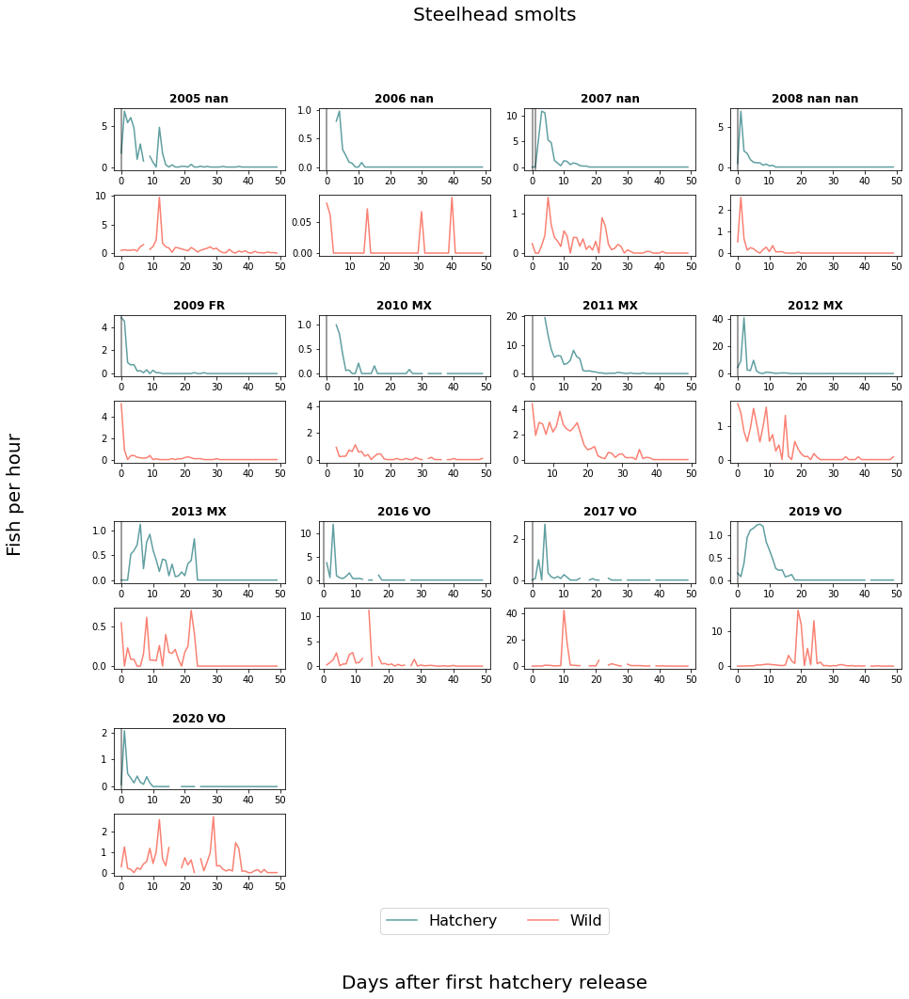

In [42]:
hatchery_visualization_paper(df_trap, "steelheadsmolt", True)